<a href="https://colab.research.google.com/github/Tensor-Reloaded/IOAI-Workshop-CV-1/blob/main/multitask/3.advanced-data-augmentation-and-tta.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Multitask - the OxfordIIITPet dataset for segmentation and classification

In [1]:
import torch
import torch.nn as nn
from torchvision.transforms import v2
from torchvision.datasets import OxfordIIITPet
from torch.utils.data import DataLoader, Dataset
import timm
import torchvision
from torchvision.transforms.v2.functional import hflip
from tqdm import tqdm
import matplotlib.pyplot as plt

In [2]:
img_size = 224
num_classes = 37

In [3]:
class ClassificationDataset(Dataset):
    def __init__(self, split, image_transforms):
        self.data = OxfordIIITPet(
            root="../data",
            download=True,
            split=split,
            target_types=("category",),
        )
        self.image_transforms = image_transforms

    def __len__(self):
        return len(self.data)

    def __getitem__(self, i):
        image, class_label = self.data[i]
        image = self.image_transforms(image)
        return image, class_label


image_transforms_train = v2.Compose([
    v2.ToImage(),
    v2.Resize([img_size, img_size]),
    v2.RandomCrop([img_size, img_size], padding=12),
    v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
    v2.AutoAugment(),
])

image_transforms_test = v2.Compose([
    v2.ToImage(),
    v2.Resize([img_size, img_size]),
    v2.ToDtype(torch.float32, scale=True),
])

cutmix_or_mixup = v2.RandomChoice([
    v2.CutMix(num_classes=num_classes),
    v2.MixUp(num_classes=num_classes),
])

train_dataset = ClassificationDataset("trainval", image_transforms_train)
test_dataset = ClassificationDataset("test", image_transforms_test)

train_loader = DataLoader(train_dataset, shuffle=True, batch_size=32, drop_last=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=32, drop_last=False)

100%|██████████| 792M/792M [00:37<00:00, 21.0MB/s]
100%|██████████| 19.2M/19.2M [00:01<00:00, 11.4MB/s]


## Automatic augmentation

1\. [AutoAugment: Learning Augmentation Policies from Data](https://arxiv.org/abs/1805.09501)
```py
from torchvision.transforms import v2

v2.AutoAugment(policy=v2.AutoAugmentPolicy.IMAGENET) (default)
v2.AutoAugment(policy=v2.AutoAugmentPolicy.SVHN)
v2.AutoAugment(policy=v2.AutoAugmentPolicy.CIFAR10)
```
2\. [RandAugment: Practical automated data augmentation with a reduced search space](https://arxiv.org/abs/1909.13719L)
```py
from torchvision.transforms import v2

v2.RandAugment(num_ops=2, magnitude=8) (default)
v2.RandAugment(num_ops=4, magnitude=4)
v2.RandAugment(num_ops=3, magnitude=10)
```

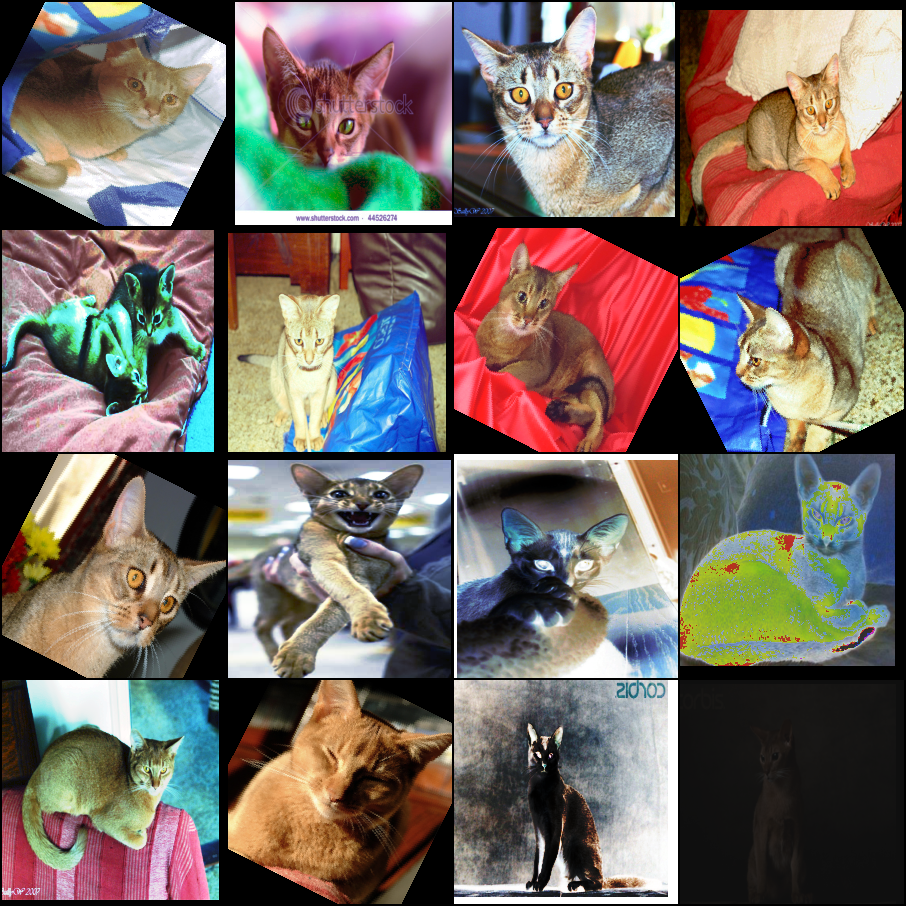

In [4]:
for images, labels in DataLoader(train_dataset, shuffle=False, batch_size=16):
    break
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

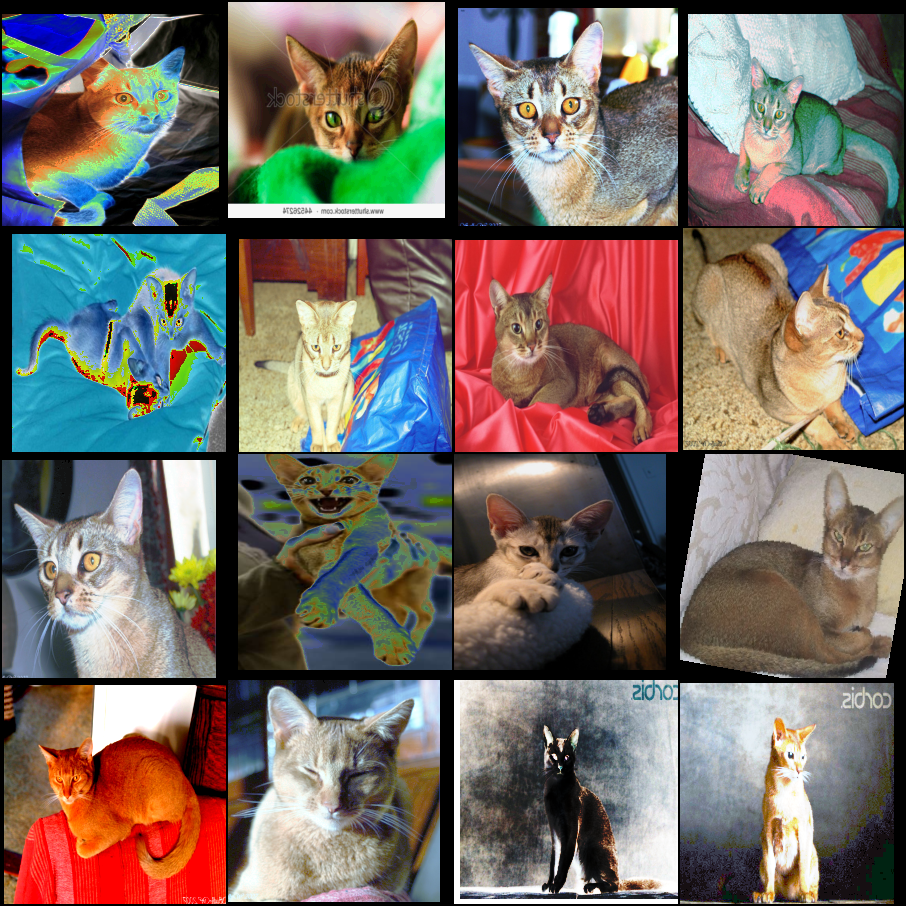

In [5]:
for images, labels in DataLoader(train_dataset, shuffle=False, batch_size=16):
    break
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

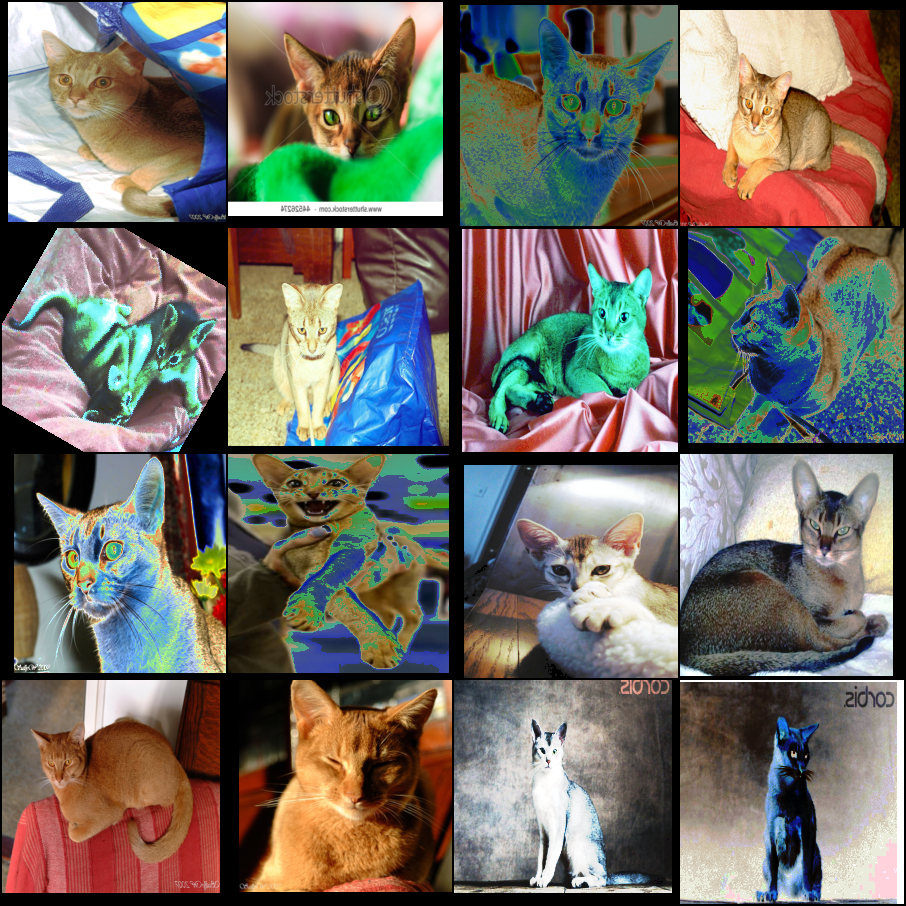

In [6]:
for images, labels in DataLoader(train_dataset, shuffle=False, batch_size=16):
    break
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

## CutMix and MixUp

* [CutMix: Regularization Strategy to Train Strong Classifiers with Localizable Features](https://arxiv.org/abs/1905.04899)
* [mixup: Beyond Empirical Risk Minimization](https://arxiv.org/abs/1710.09412)

```py
from torchvision.transforms import v2

v2.RandomChoice([
    v2.CutMix(num_classes=num_classes),
    v2.MixUp(num_classes=num_classes),
])
```

### CutMix

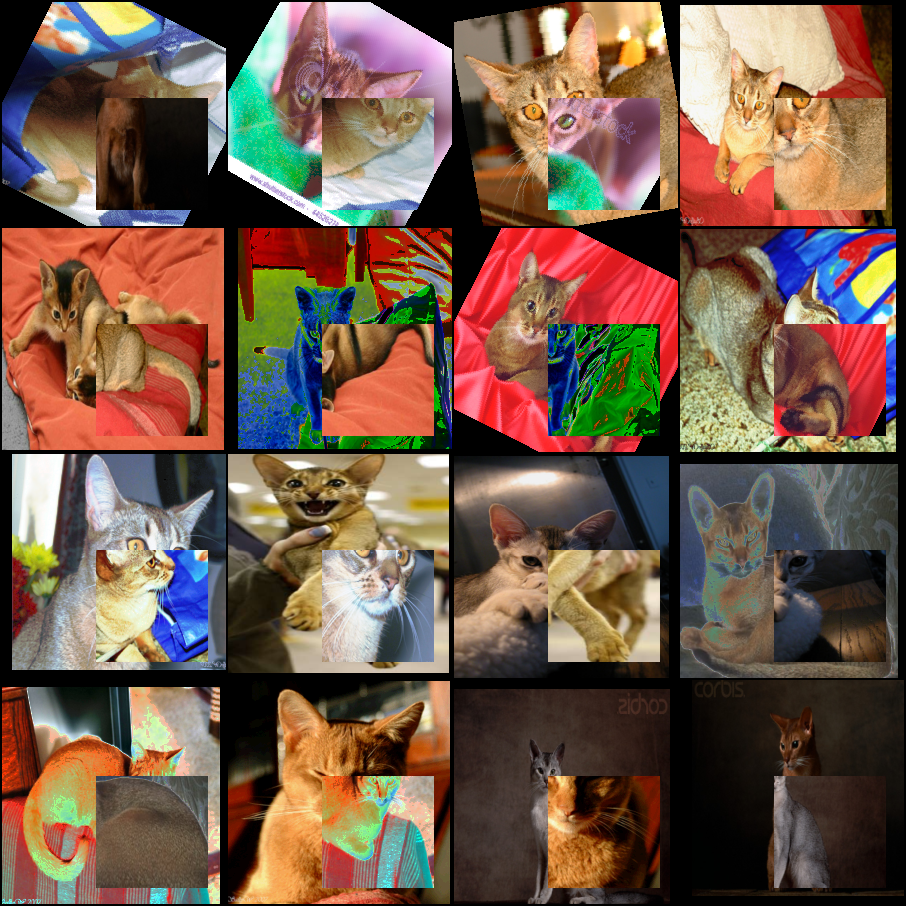

In [7]:
for images, labels in DataLoader(train_dataset, shuffle=False, batch_size=16):
    break
images, labels  = v2.CutMix(num_classes=num_classes)(images, labels)
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

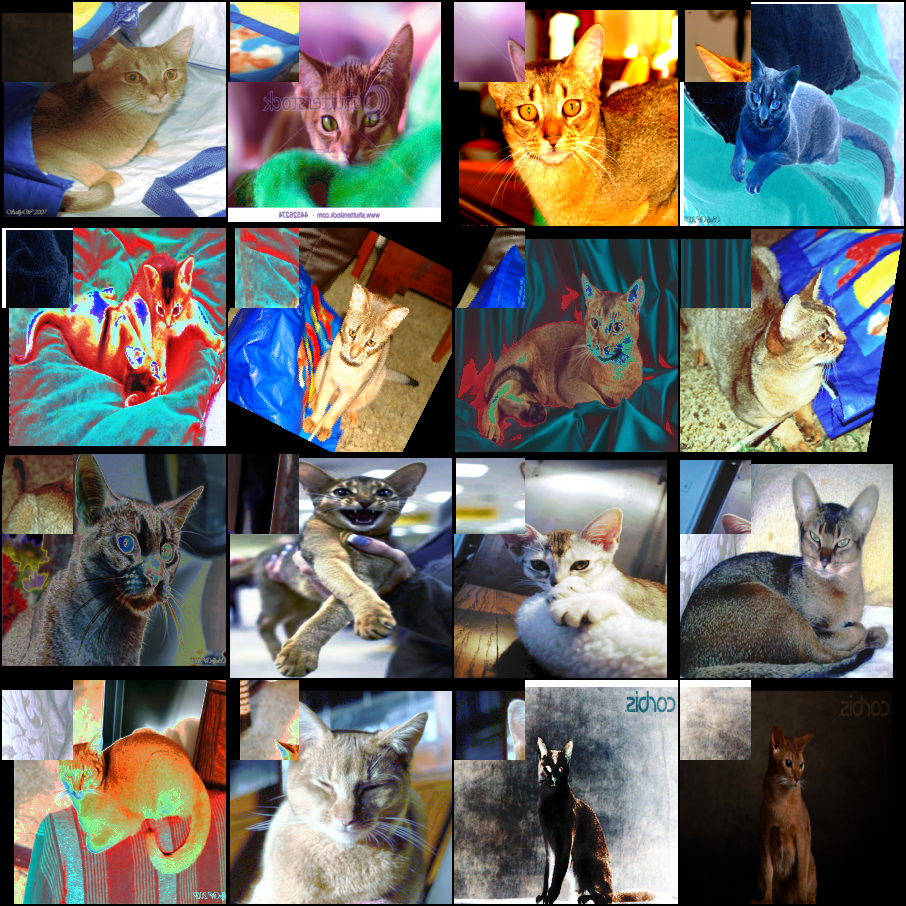

In [8]:
for images, labels in DataLoader(train_dataset, shuffle=False, batch_size=16):
    break
images, labels  = v2.CutMix(num_classes=num_classes)(images, labels)
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

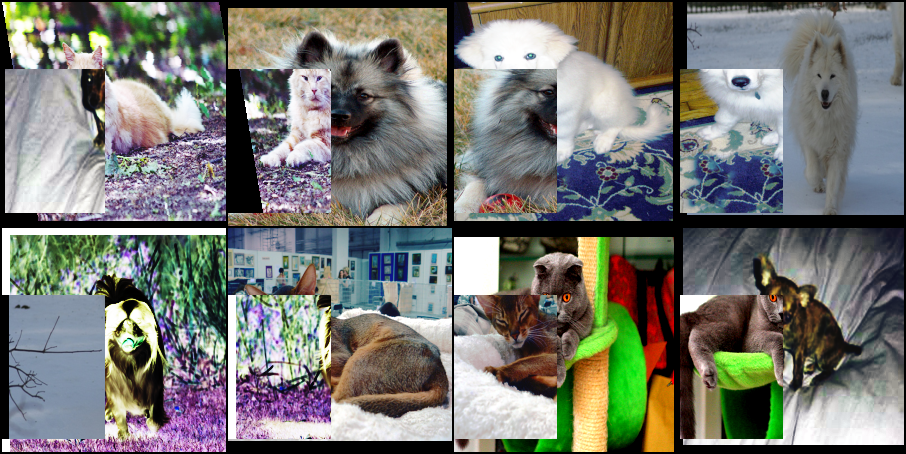

In [9]:
for images, labels in DataLoader(train_dataset, shuffle=True, batch_size=8):
    break
images, labels  = v2.CutMix(num_classes=num_classes)(images, labels)
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

In [10]:
def draw_all(to_draw, labels):
    size = num_classes // 4
    for i in range(len(to_draw)):
        plt.imshow(v2.functional.to_pil_image(to_draw[i]))
        label = labels[i]
        label = [round(x, 4) for x in label.tolist()]
        label = '\n'.join([str(label[i * size: (i + 1) * size]) for i in range(4)])
        plt.title(label)
        plt.axis("off")
        plt.show()

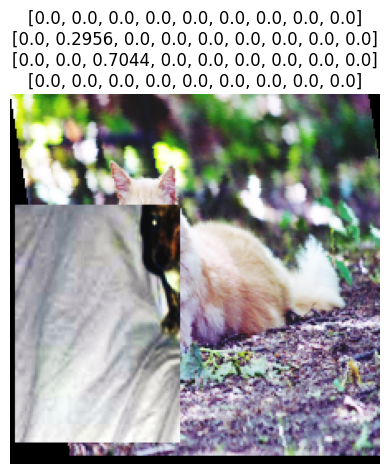

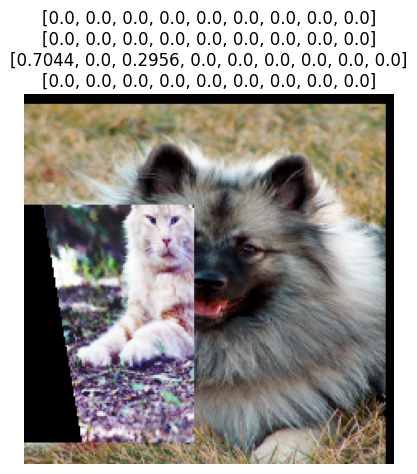

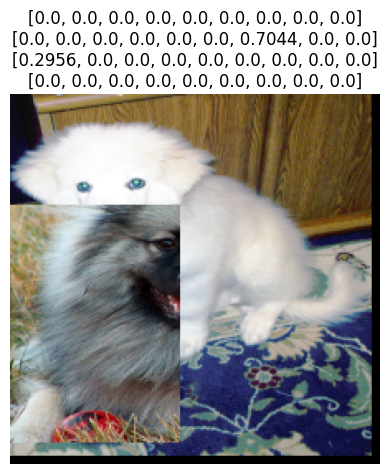

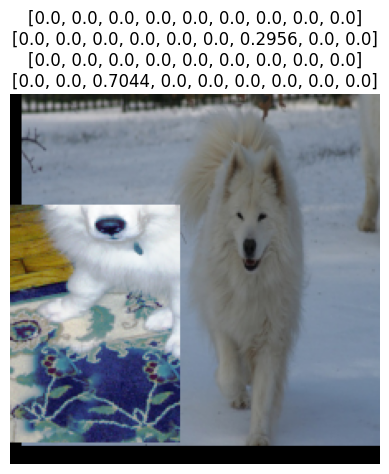

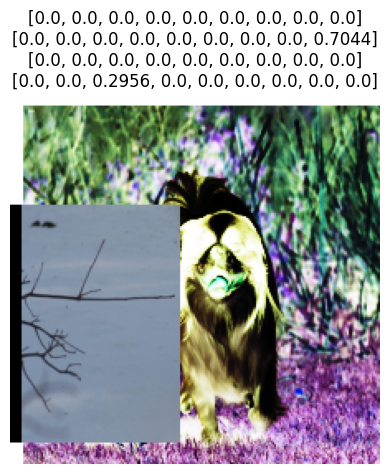

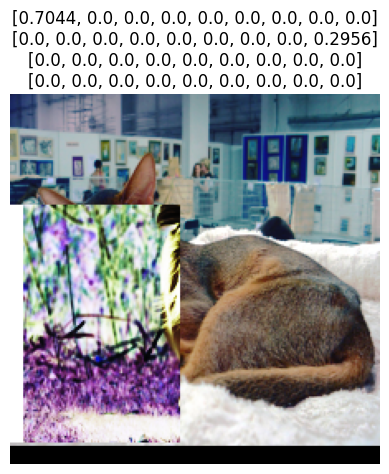

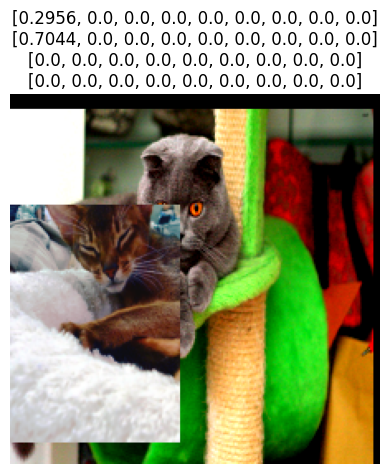

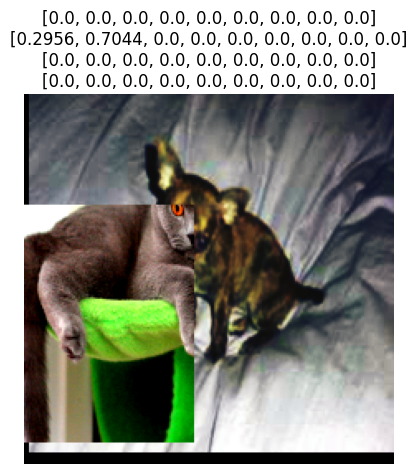

In [11]:
draw_all(images, labels)

### MixUp

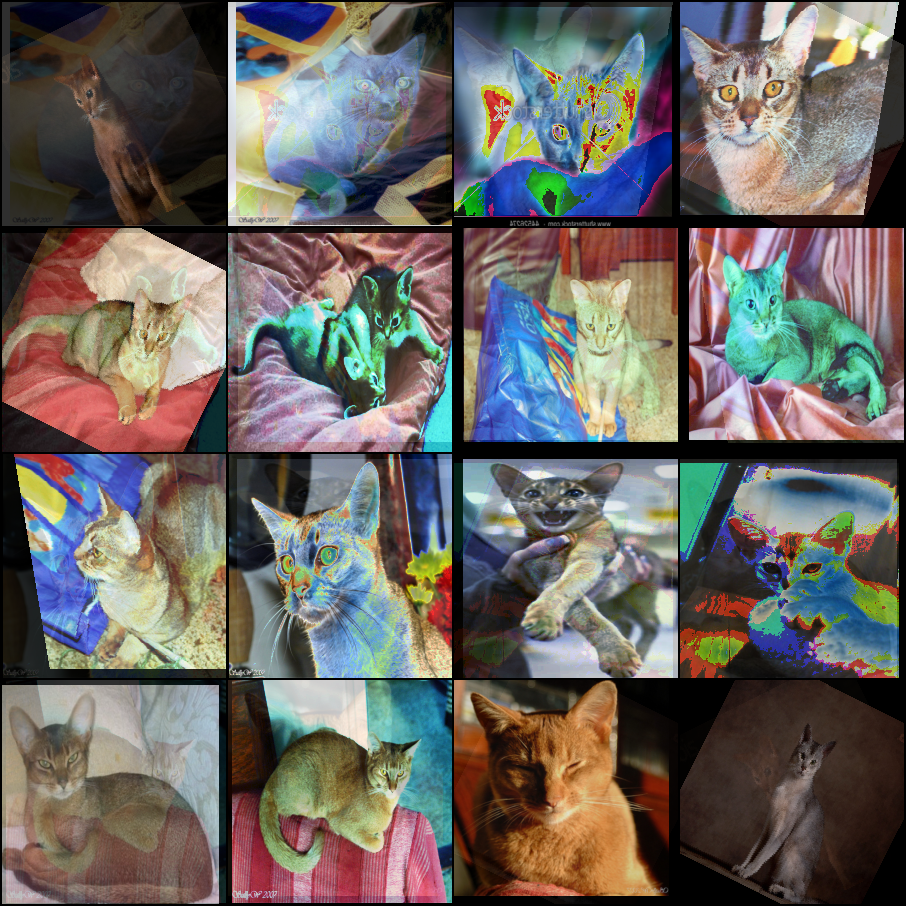

In [12]:
for images, labels in DataLoader(train_dataset, shuffle=False, batch_size=16):
    break
images, labels  = v2.MixUp(num_classes=num_classes)(images, labels)
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

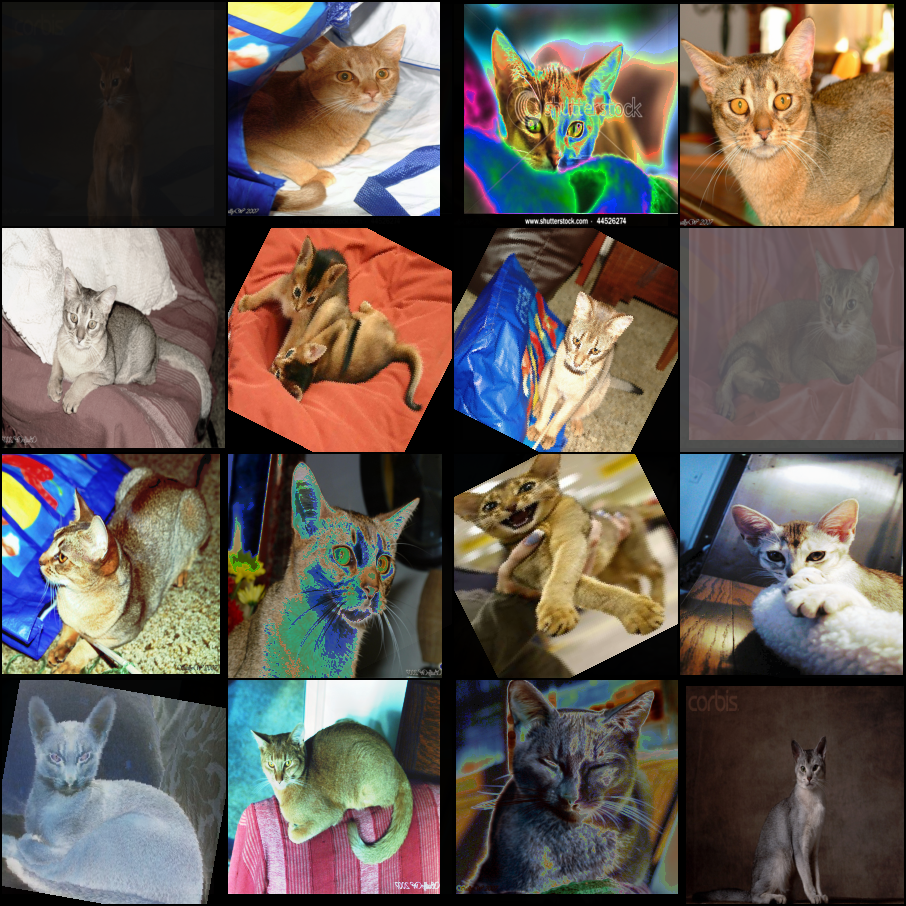

In [13]:
for images, labels in DataLoader(train_dataset, shuffle=False, batch_size=16):
    break
images, labels  = v2.MixUp(num_classes=num_classes)(images, labels)
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

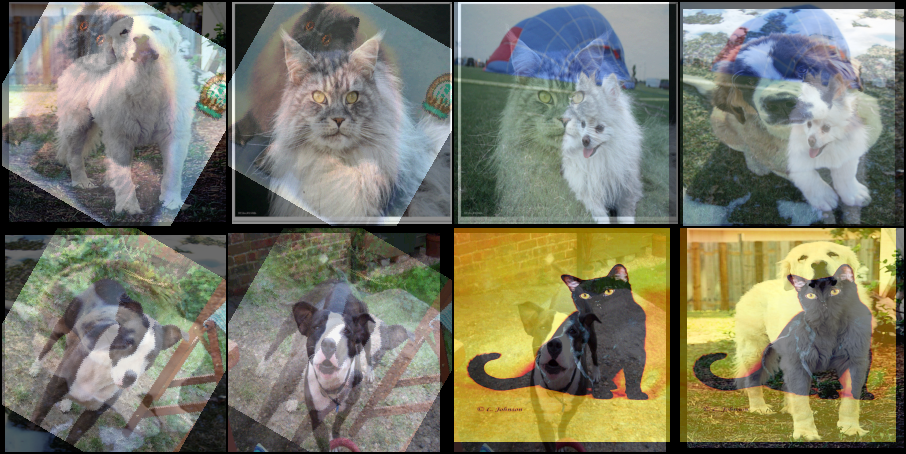

In [14]:
for images, labels in DataLoader(train_dataset, shuffle=True, batch_size=8):
    break
images, labels  = v2.MixUp(num_classes=num_classes)(images, labels)
v2.functional.to_pil_image(torchvision.utils.make_grid(images, nrow=4))

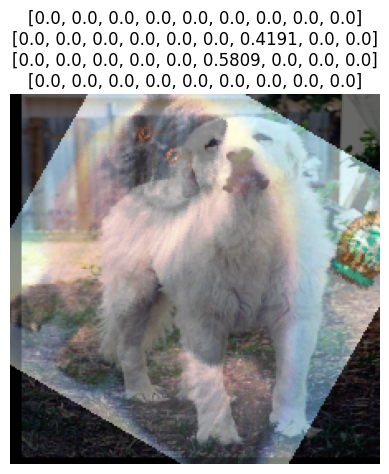

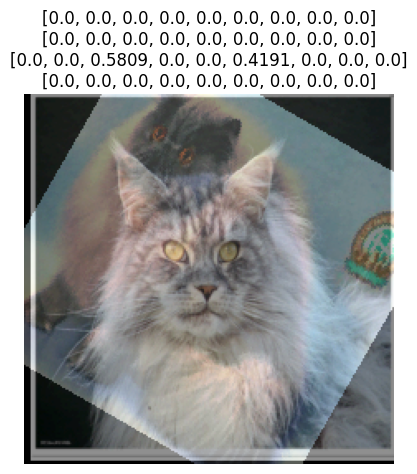

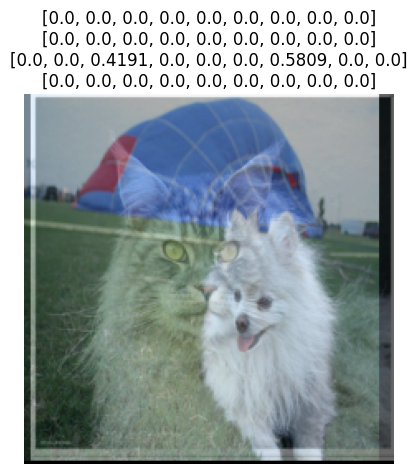

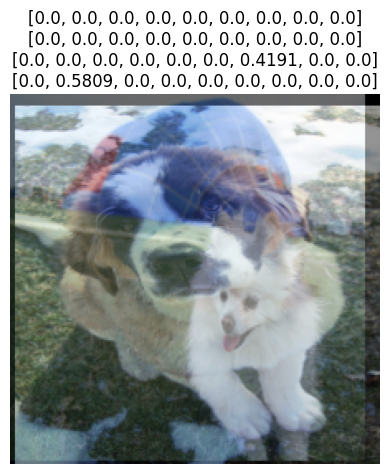

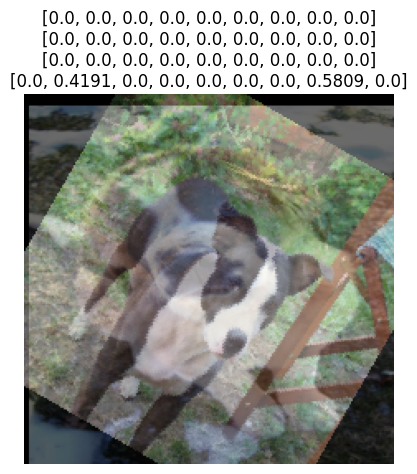

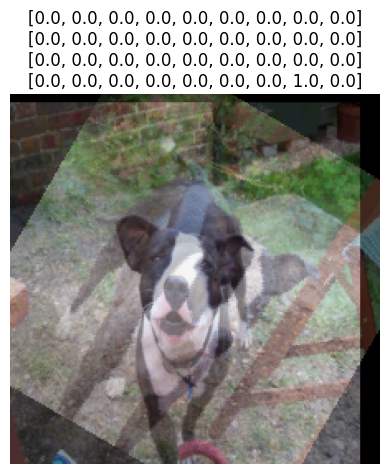

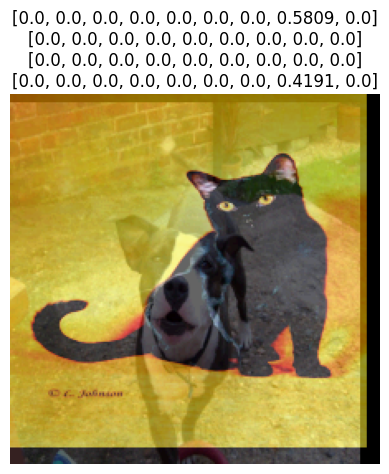

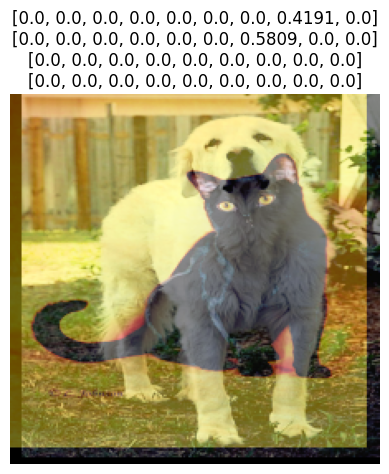

In [15]:
draw_all(images, labels)

## Other Data Augmentation techniques

The [Mozaic](https://arxiv.org/pdf/2004.12432) Data Augmentation.

For Object detection & segmentation tasks, see https://github.com/albumentations-team/albumentations.


# Test Time Augmentation

In [16]:
class ClassificationModel(nn.Module):
    def __init__(self, backbone_name='resnet18', num_classes=num_classes):
        super().__init__()
        self.backbone = timm.create_model(backbone_name, pretrained=True)
        self.backbone.fc = nn.Linear(self.backbone.fc.weight.size(1), num_classes)

    def forward(self, x):
        return self.backbone(x)


In [17]:
def f1_score(x, y):
    x_sum = x.sum().item()
    y_sum = y.sum().item()

    if x_sum == y_sum == 0:
        return 1.0
    elif x_sum == 0 or y_sum == 0:
        return 0.0

    return 2.0 * (x & y).sum().item() / (x_sum + y_sum)


def f1_macro(predicted, targets, num_classes):
    f1s = []
    for cls in range(num_classes):
        f1s.append(f1_score(predicted == cls, targets == cls))
    return sum(f1s) / num_classes


In [18]:
device = torch.accelerator.current_accelerator() if torch.accelerator.is_available() else torch.device("cpu")
print("Using device", device)
# model = ClassificationModel().to(device)
model = ClassificationModel("hf_hub:timm/resnest14d.gluon_in1k").to(device)
classification_criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3)


Using device cuda


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/567 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/42.6M [00:00<?, ?B/s]

In [19]:
def train():
    loss_sum = 0.0
    num_batches = 0

    model.train()
    pbar = tqdm(train_loader, desc="Training")
    for images, labels in pbar:
        images = images.to(device)
        labels = labels.to(device)

        images, labels = cutmix_or_mixup(images, labels)

        with torch.autocast(device.type, enabled=device.type == 'cuda'):
            class_logits = model(images)
            loss = classification_criterion(class_logits, labels)

        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        loss_sum += loss.item()
        num_batches += 1

        pbar.set_postfix({
            'Loss': f'{loss.item():.4f}',
        })

    return loss_sum / num_batches


@torch.inference_mode()
def val():
    cls_f1_sum = 0.0
    cls_acc_sum = 0.0
    loss_sum = 0.0
    num_batches = 0

    model.eval()
    pbar = tqdm(test_loader, desc="Evaluating")
    for images, labels in pbar:
        images = images.to(device)
        labels = labels.to(device)

        with torch.autocast(device.type, enabled=device.type == 'cuda'):
            class_logits = model(images)
            loss = classification_criterion(class_logits, labels)

            pred_classes = class_logits.argmax(dim=1)

            cls_f1 = f1_macro(pred_classes, labels, num_classes=num_classes)
            cls_acc = (pred_classes == labels).float().mean().item()

        cls_f1_sum += cls_f1
        cls_acc_sum += cls_acc
        loss_sum += loss
        num_batches += 1

        pbar.set_postfix({
            'Loss': f'{loss.item():.4f}',
            'ClsF1': f'{cls_f1:.4f}',
            'ClsAcc': f'{cls_acc:.4f}',
        })

    return (
        cls_f1_sum / num_batches,
        cls_acc_sum / num_batches,
        loss_sum / num_batches,
    )


@torch.inference_mode()
def val_tta(tta_type):
    cls_f1_sum = 0.0
    cls_acc_sum = 0.0
    num_batches = 0

    model.eval()
    pbar = tqdm(test_loader, desc=f"Evaluating with TTA level {level}")

    for images, labels in pbar:
        images = images.to(device)
        labels = labels.to(device)

        with torch.autocast(device.type, enabled=device.type == 'cuda'):
            combined = [images]
            if tta_type == "mirroring":
                combined.append(hflip(images))
            elif tta_type == "translate":  # left
                padding_size = 2
                padded = v2.functional.pad(images, [padding_size])
                for i in [-2, 0, 2]:
                    for j in [-2, 0, 2]:
                        if i == 0 and j == 0:
                            continue
                        x = padding_size + i
                        y = padding_size + j
                        combined.append(padded[:, :, x:x + img_size, y:y + img_size])
            elif tta_type == "mirroring_and_translate":
                combined.append(hflip(images))
                padding_size = 2
                padded = v2.functional.pad(images, [padding_size])
                for i in [-2, 0, 2]:
                    for j in [-2, 0, 2]:
                        if i == 0 and j == 0:
                            continue
                        x = padding_size + i
                        y = padding_size + j
                        aux = padded[:, :, x:x + img_size, y:y + img_size]
                        combined.append(aux)
                        combined.append(hflip(aux))
            elif tta_type == "translate_aggressive":
                padding_size = 4
                padded = v2.functional.pad(images, [padding_size])
                for i in [-4, -2, 0, 2, 4]:
                    for j in [-4, -2, 0, 2, 4]:
                        if i == 0 and j == 0:
                            continue
                        x = padding_size + i
                        y = padding_size + j
                        combined.append(padded[:, :, x:x + img_size, y:y + img_size])

            outputs = sum(model(x) for x in combined)
        outputs = outputs.argmax(dim=1)

        cls_f1 = f1_macro(outputs, labels, num_classes=num_classes)
        cls_acc = (outputs == labels).float().mean().item()

        cls_f1_sum += cls_f1
        cls_acc_sum += cls_acc
        num_batches += 1

        pbar.set_postfix({
            'ClsF1': f'{cls_f1:.4f}',
            'ClsAcc': f'{cls_acc:.4f}',
        })

    return (
        cls_f1_sum / num_batches,
        cls_acc_sum / num_batches,
    )


In [20]:
model.requires_grad_(False)
model.backbone.fc.requires_grad_(True)
num_epochs = 10
for epoch in range(num_epochs):
    print(f"\nEpoch {epoch + 1}/{num_epochs}")
    tr_loss = train()
    vl_cls_f1, vl_cls_acc, vl_loss = val()
    print(f"[Train]                                | Loss: {tr_loss:.4f}")
    print(f"[Val]   ClsF1: {vl_cls_f1:.4f} | ClsAcc: {vl_cls_acc:.4f} | Loss: {vl_loss:.4f}")



Epoch 1/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  5.79it/s, Loss=1.3982, ClsF1=0.9693, ClsAcc=0.7619]


[Train]                                | Loss: 2.7799
[Val]   ClsF1: 0.8874 | ClsAcc: 0.7286 | Loss: 1.3950

Epoch 2/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  5.91it/s, Loss=0.8005, ClsF1=0.9431, ClsAcc=0.8095]


[Train]                                | Loss: 2.1492
[Val]   ClsF1: 0.9101 | ClsAcc: 0.7861 | Loss: 1.1033

Epoch 3/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  5.99it/s, Loss=0.9712, ClsF1=0.9439, ClsAcc=0.8571]


[Train]                                | Loss: 2.1869
[Val]   ClsF1: 0.9117 | ClsAcc: 0.8208 | Loss: 1.0707

Epoch 4/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  5.83it/s, Loss=0.7836, ClsF1=0.9439, ClsAcc=0.8571]


[Train]                                | Loss: 1.9760
[Val]   ClsF1: 0.9109 | ClsAcc: 0.8181 | Loss: 0.9140

Epoch 5/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  5.86it/s, Loss=0.8824, ClsF1=0.9161, ClsAcc=0.8095]


[Train]                                | Loss: 2.0169
[Val]   ClsF1: 0.9146 | ClsAcc: 0.8209 | Loss: 0.9509

Epoch 6/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  6.02it/s, Loss=1.0176, ClsF1=0.9161, ClsAcc=0.8095]


[Train]                                | Loss: 1.9728
[Val]   ClsF1: 0.9174 | ClsAcc: 0.8296 | Loss: 0.9181

Epoch 7/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  5.85it/s, Loss=0.8846, ClsF1=0.9161, ClsAcc=0.8095]


[Train]                                | Loss: 1.9152
[Val]   ClsF1: 0.9183 | ClsAcc: 0.8242 | Loss: 0.8733

Epoch 8/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  6.01it/s, Loss=0.9242, ClsF1=0.9168, ClsAcc=0.8571]


[Train]                                | Loss: 1.8986
[Val]   ClsF1: 0.9189 | ClsAcc: 0.8319 | Loss: 0.8741

Epoch 9/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  5.83it/s, Loss=0.5919, ClsF1=0.9446, ClsAcc=0.9048]


[Train]                                | Loss: 1.9687
[Val]   ClsF1: 0.9156 | ClsAcc: 0.8302 | Loss: 0.8547

Epoch 10/10


Evaluating: 100%|██████████| 115/115 [00:19<00:00,  5.84it/s, Loss=1.0420, ClsF1=0.9701, ClsAcc=0.8095]

[Train]                                | Loss: 1.9691
[Val]   ClsF1: 0.9153 | ClsAcc: 0.8280 | Loss: 0.8661


In [21]:
results = []
for level in ["no_tta", "mirroring", "translate", "mirroring_and_translate", "translate_aggressive"]:
    val_f1_tta, val_acc_tta = val_tta(level)
    results.append((level, val_f1_tta, val_acc_tta))

Evaluating with TTA level translate: 100%|██████████| 115/115 [00:47<00:00,  2.44it/s, ClsF1=0.9701, ClsAcc=0.8095]
Evaluating with TTA level mirroring_and_translate: 100%|██████████| 115/115 [01:23<00:00,  1.38it/s, ClsF1=0.9431, ClsAcc=0.8095]
Evaluating with TTA level translate_aggressive: 100%|██████████| 115/115 [01:47<00:00,  1.07it/s, ClsF1=0.9431, ClsAcc=0.8095]


In [22]:
for level, val_f1_tta, val_acc_tta in results:
    print(f"{level: <25} ClsF1: {val_f1_tta:.4f} | ClsAcc: {val_acc_tta:.4f}")

no_tta                    ClsF1: 0.9153 | ClsAcc: 0.8280
mirroring                 ClsF1: 0.9173 | ClsAcc: 0.8334
translate                 ClsF1: 0.9236 | ClsAcc: 0.8429
mirroring_and_translate   ClsF1: 0.9251 | ClsAcc: 0.8464
translate_aggressive      ClsF1: 0.9254 | ClsAcc: 0.8511
